# Script to plot cells from specific clusters over the H&E images

In [6]:
import SimpleITK as sitk
import scanpy as sc
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import matplotlib.patches as patches
from skimage.transform import rescale
from PIL import Image
import tifffile
import seaborn as sns
plt.rc('legend', fontsize = 'large')
plt.rc('legend', markerscale = 3)

In [2]:
adata = sc.read_h5ad('/common/lamt2/HPV/data/xenium/adata/adata_leiden_primary_v1_Epithelial_v3_latent_17_layers_4.h5ad')

In [3]:
# For our anndata, batch is a unique identifier for each core. I have it defined using {slide_idx}___{core_idx}
adata.obs['batch'] = adata.obs['slide'].astype(str) + '___' + adata.obs['core_idx'].astype(str)
n_cells = adata.obs.groupby(['batch', 'leiden_0p5']).size()
frac_cells = n_cells / adata.obs.groupby(['batch']).size()

/tmp/ipykernel_1207511/1929239115.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  n_cells = adata.obs.groupby(['batch', 'leiden_0p5']).size()


In [4]:
# Dictionary to get the h&e slide names from the xenium output name
anno_dict = {
    '20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060075__Region_1__20250213__202651': 'ag_hpv_01',
    '20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060077__Region_1__20250213__202651': 'ag_hpv_02',
    '20250224__233848__X206_2242025_ANOGENTMA_03_04/output-XETG00206__0060354__Region_1__20250224__233922': 'ag_hpv_04',
    '20250224__233848__X206_2242025_ANOGENTMA_03_04/output-XETG00206__0060367__Region_1__20250224__233922': 'ag_hpv_03',
    '20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817': 'ag_hpv_06',
    '20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0060395__Region_1__20250304__005817': 'ag_hpv_05',
    '20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060364__Region_1__20250305__223715': 'ag_hpv_08',
    '20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060366__Region_1__20250305__223715': 'ag_hpv_07',
    '20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017': 'ag_hpv_09',
    '20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060493__Region_1__20250312__004017': 'ag_hpv_10'
}

# Category (slide naming) to pathology
cat_dict = {
    'ANOGENTMA': 'invasive',
    'HPVTMA': 'in_situ'
}

In [5]:
core_idx_df = pd.read_csv('/common/lamt2/HPV/data/xenium/alignment_v2/cropped_cores.csv', index_col = 0)
sf = 0.2125
LEVEL = 4
ntop = 3
slide_idx_df = pd.read_csv('/common/lamt2/HPV/data/xenium/alignment_v2/cropped_slides.csv', index_col = 0)

dir_out = '/common/lamt2/HPV/figs/cores_epithelial/primary_v1_Epithelial_v3'

Plotting top cores for cluster 0
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___30


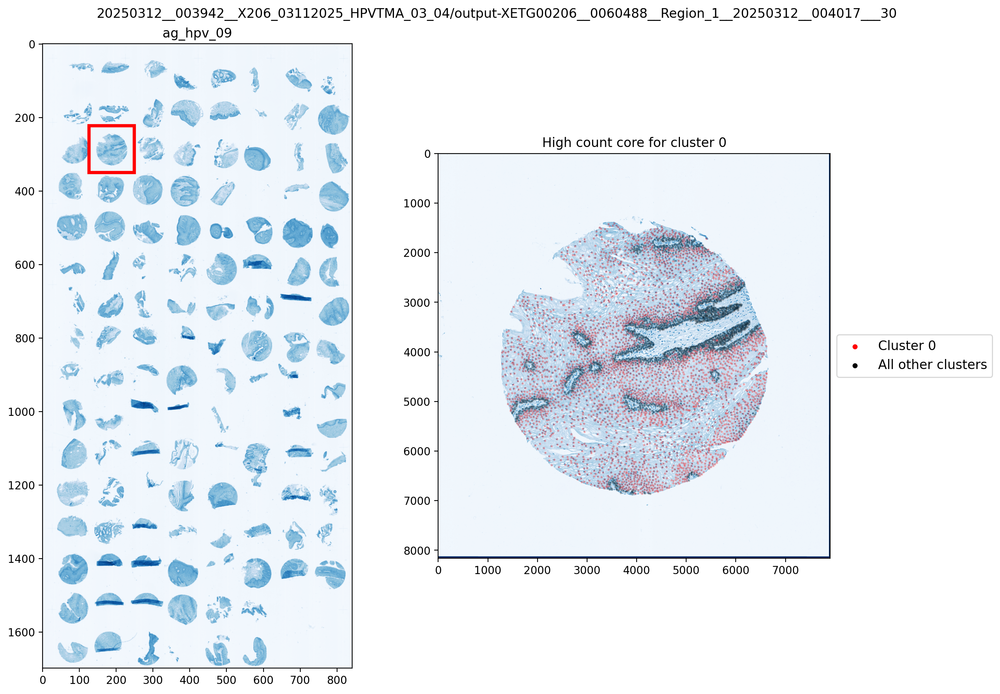

   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060366__Region_1__20250305__223715___30
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___12
   20250224__233848__X206_2242025_ANOGENTMA_03_04/output-XETG00206__0060367__Region_1__20250224__233922___35
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0060395__Region_1__20250304__005817___40
   20250224__233848__X206_2242025_ANOGENTMA_03_04/output-XETG00206__0060367__Region_1__20250224__233922___36
Plotting top cores for cluster 1
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___127
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060364__Region_1__20250305__223715___98
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060366__Region_1__20250305__223715___116
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060077__Region_1__20250213__202651

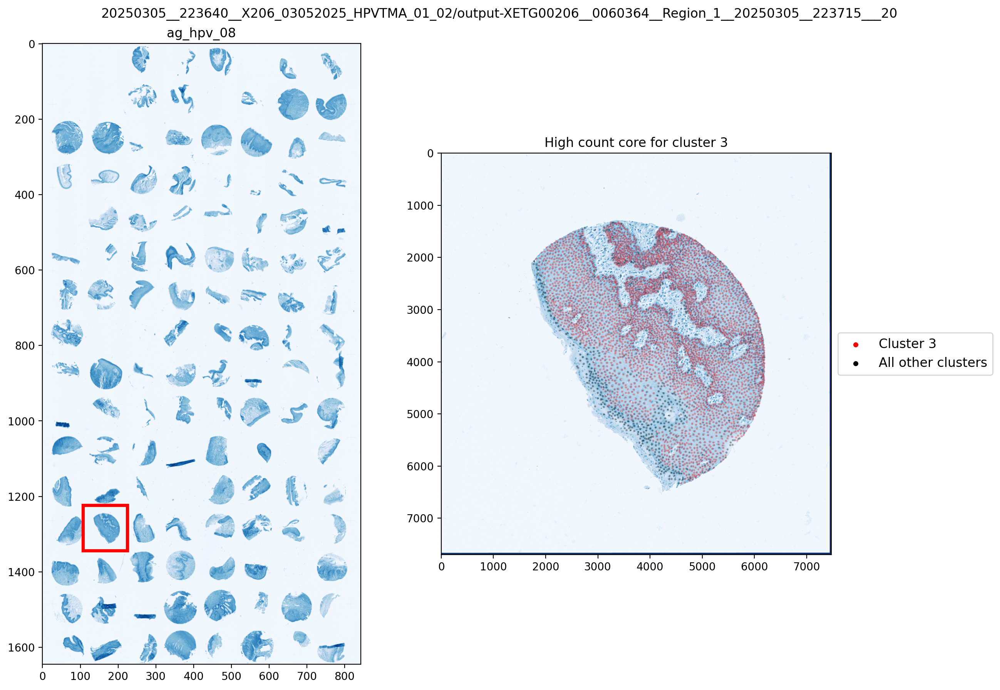

   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0060395__Region_1__20250304__005817___17
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817___44
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060077__Region_1__20250213__202651___18
Plotting top cores for cluster 4
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___2
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___115
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___122
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817___27
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060077__Region_1__20250213__202651___13
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__0

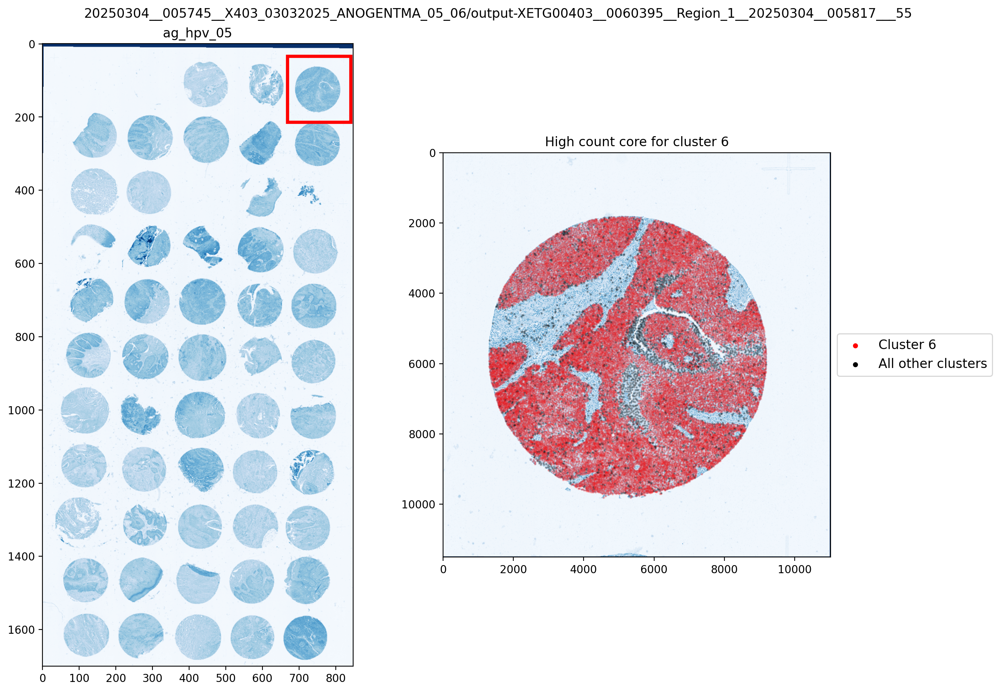

   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817___18
Plotting top cores for cluster 7
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___28
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060493__Region_1__20250312__004017___76
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060364__Region_1__20250305__223715___108
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060077__Region_1__20250213__202651___51
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817___10
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060077__Region_1__20250213__202651___40
Plotting top cores for cluster 8
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060364__Region_1__20250305__223715___101
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__00

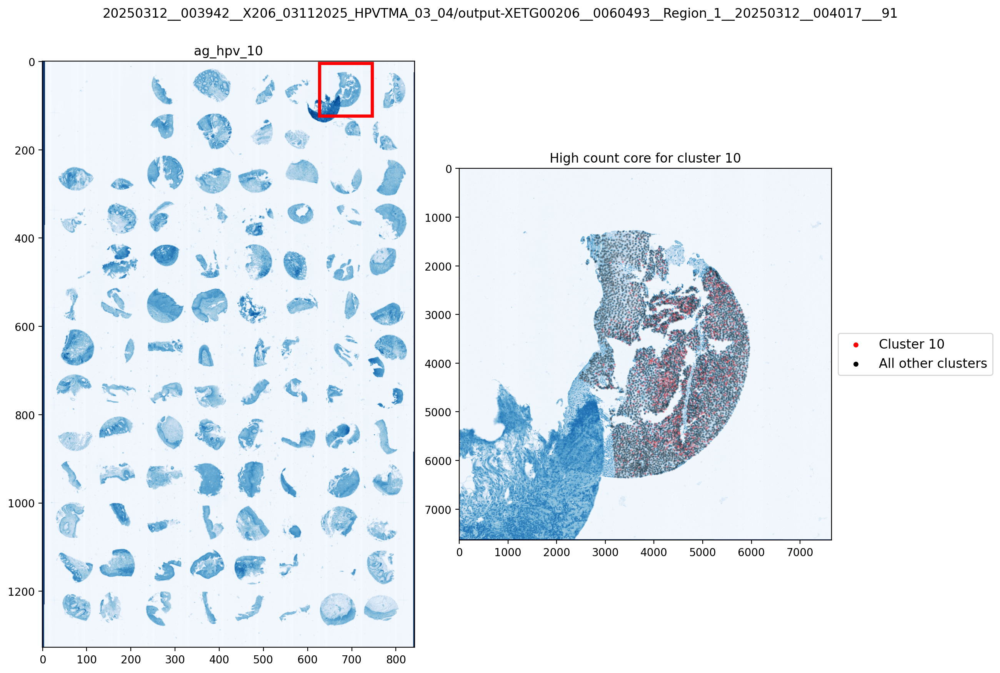

   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060493__Region_1__20250312__004017___38
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___13
   20250224__233848__X206_2242025_ANOGENTMA_03_04/output-XETG00206__0060354__Region_1__20250224__233922___28
   20250224__233848__X206_2242025_ANOGENTMA_03_04/output-XETG00206__0060354__Region_1__20250224__233922___18
   20250224__233848__X206_2242025_ANOGENTMA_03_04/output-XETG00206__0060354__Region_1__20250224__233922___55
Plotting top cores for cluster 11
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060366__Region_1__20250305__223715___127
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___20
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___26
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__00581

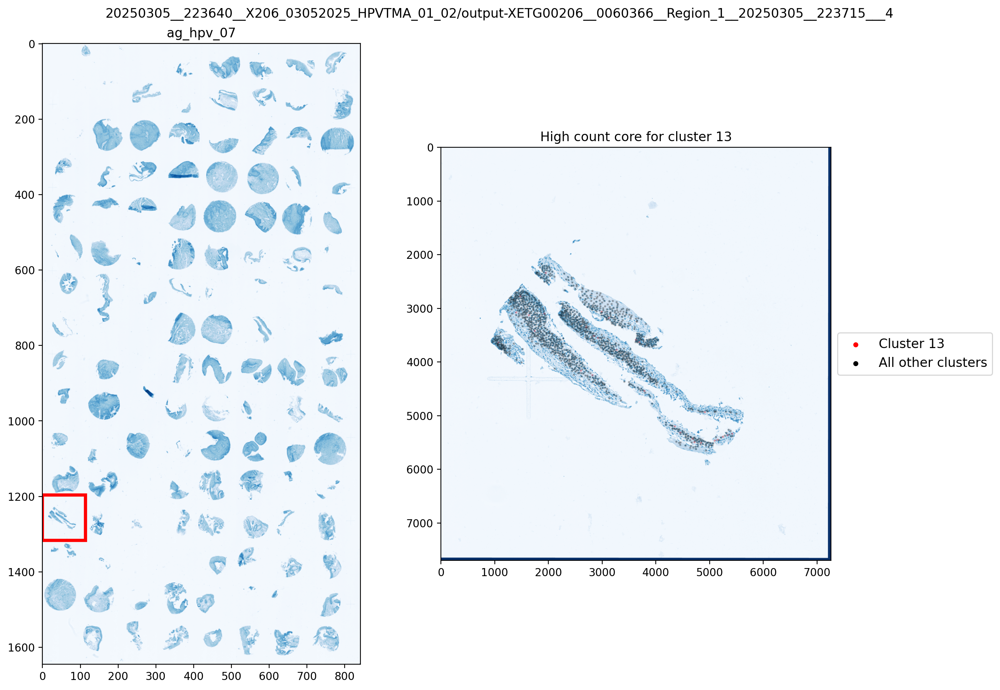

   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817___41
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817___13
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060075__Region_1__20250213__202651___46
Plotting top cores for cluster 14
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060493__Region_1__20250312__004017___52
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060364__Region_1__20250305__223715___66
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___86
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060075__Region_1__20250213__202651___14
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060075__Region_1__20250213__202651___40
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060075__Region_1__20250213__20265

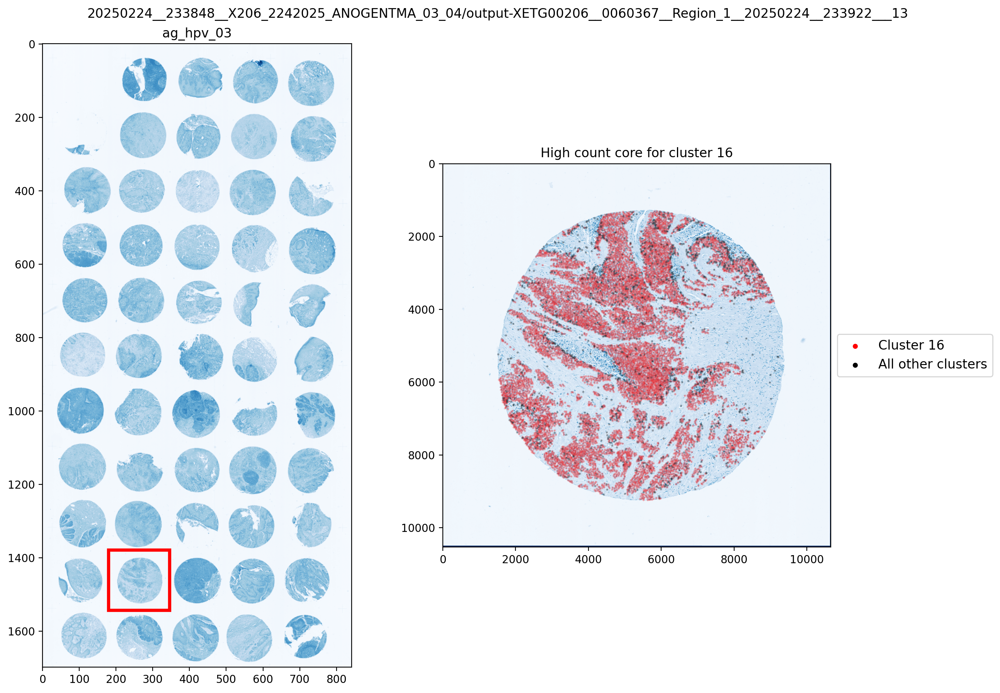

   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0060395__Region_1__20250304__005817___7
Plotting top cores for cluster 17
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060366__Region_1__20250305__223715___4
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___9
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___59
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817___31
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0060395__Region_1__20250304__005817___34
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817___49
Plotting top cores for cluster 18
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060493__Region_1__20250312__004017___74
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0

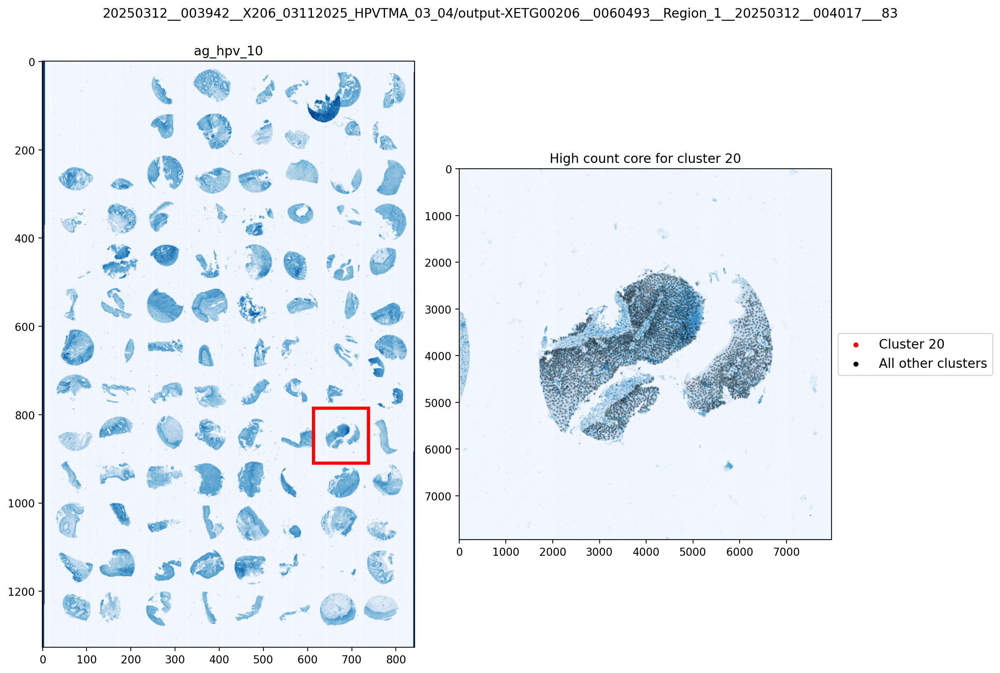

   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060366__Region_1__20250305__223715___23
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060364__Region_1__20250305__223715___62
   20250304__005745__X403_03032025_ANOGENTMA_05_06/output-XETG00403__0059911__Region_1__20250304__005817___45
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060077__Region_1__20250213__202651___45
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060075__Region_1__20250213__202651___45
Plotting top cores for cluster 21
   20250305__223640__X206_03052025_HPVTMA_01_02/output-XETG00206__0060366__Region_1__20250305__223715___127
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060493__Region_1__20250312__004017___37
   20250312__003942__X206_03112025_HPVTMA_03_04/output-XETG00206__0060488__Region_1__20250312__004017___20
   20250213__202616__X206_02132025_ANOGENTMA_1_2/output-XETG00206__0060075__Region_1__20250213__202651__

In [11]:
# Plot cores with the highest absolute counts for each cluster in invasive and in-situ
i = 0
for c in n_cells.index.get_level_values('leiden_0p5').unique():
    print (f'Plotting top cores for cluster {c}')

    cells = n_cells[n_cells.index.get_level_values('leiden_0p5') == c]
    cells = cells.sort_values(ascending = False)
    for cat in ['HPVTMA', 'ANOGENTMA']:
        for n, (idx, row) in enumerate(cells[cells.index.get_level_values('batch').str.contains(cat)].iloc[:ntop].items()):
            print (f'   {idx[0]}')
                    
            batch = idx[0]
            slide = batch.split('/')[-1].split('___')[0]
            core = int(batch.split('/')[-1].split('___')[-1])
            
            fig, ax = plt.subplots(1, 2, figsize = (2*6.444, 8.854), dpi = 200, constrained_layout = True)
            fig.suptitle(batch)
            
            # Use the cropping indices to get the offsets for the cell x/y coordinates
            core_idx = core_idx_df.loc[batch]
            slide_idx = slide_idx_df.loc[batch.split('___')[0]]
            xs = adata[(adata.obs['batch'] == batch) & (adata.obs['leiden_0p5'] == c)].obs['x_centroid']/sf - core_idx.x0 * (2**LEVEL)
            ys = adata[(adata.obs['batch'] == batch) & (adata.obs['leiden_0p5'] == c)].obs['y_centroid']/sf - core_idx.y0 * (2**LEVEL)
            
            xs_other = adata[(adata.obs['batch'] == batch) & (adata.obs['leiden_0p5'] != c)].obs['x_centroid']/sf - core_idx.x0 * (2**LEVEL)
            ys_other = adata[(adata.obs['batch'] == batch) & (adata.obs['leiden_0p5'] != c)].obs['y_centroid']/sf - core_idx.y0 * (2**LEVEL)
            
            # Read in the numpy array of the aligned h&e core
            arr_core = np.load(f'/common/lamt2/HPV/data/xenium/alignment_v2/aligned_cores/{batch.split('/')[-1]}.npy')
            
            # Read in the slide and align
            f_tiff = f'/common/knottsilab/xenium/hpv/svs/{anno_dict[batch.split('___')[0]]}.tiff'
            image_he = tifffile.imread(f_tiff, is_ome = False, level = 5)
            arrm= rescale(image_he.astype('float32'), 0.6, anti_aliasing=False)[:,:,0]
            arrm_r = np.rot90(arrm)
            arrm_r = arrm_r.max() - arrm_r
            
            arrm_rc = arrm_r[arrm_r.shape[0] - int(slide_idx.x1*0.6):arrm_r.shape[0] - int(slide_idx.x0*0.6), int(slide_idx.y0*0.6):int(slide_idx.y1*0.6)]
            arrm_rc *= (255.0/arrm_rc.max())
            arrm_rc = 255-arrm_rc
            
            image_he= sitk.GetImageFromArray(arrm_rc.astype('float32'))

            # Read DAPI image for reference
            f_fix = f'/common/knottsilab/xenium/hpv/{batch.split('___')[0]}/morphology_focus/morphology_mip_level_6.png'
            arr_dapi = np.array(Image.open(f_fix))
            image_dapi = sitk.GetImageFromArray(arr_dapi.astype('float32'))
            modelnm = f'/common/lamt2/HPV/data/xenium/alignment_v2/aligned_slides/tfm_{slide}.hdf'
            outTx_ogto0 = sitk.ReadTransform(modelnm)

            # Do the slide alignment
            resampler = sitk.ResampleImageFilter()
            resampler.SetReferenceImage(image_dapi)
            resampler.SetInterpolator(sitk.sitkLinear)
            resampler.SetDefaultPixelValue(0)
            resampler.SetTransform(outTx_ogto0)
            
            aligned_he = resampler.Execute(image_he)
            arr_slide = sitk.GetArrayFromImage(aligned_he)

            # Plot the whole slide and box the core that we are plotting (for Joe's reference)
            ax[0].imshow(arr_slide, cmap = 'Blues_r')
            rect = patches.Rectangle((core_idx.x0 / 4, core_idx.y0 / 4), (core_idx.x1 - core_idx.x0) / 4, (core_idx.y1 - core_idx.y0) / 4, linewidth=3, edgecolor='r', facecolor='none')
            ax[0].add_patch(rect)
            ax[0].set_title(anno_dict[batch.split('___')[0]])
            
            # Plot the core and the cells
            ax[1].imshow(arr_core[:,:,1], cmap = 'Blues_r')
            ax[1].scatter(
                xs,
                ys,
                s = min(1.5, 120000 / (len(xs) + len(xs_other))),
                c = 'Red',
                alpha = 0.2,
                label = f'Cluster {c}'
            )
            ax[1].scatter(
                xs_other,
                ys_other,
                s = min(1.5, 120000 / (len(xs) + len(xs_other))),
                c = 'Black',
                alpha = 0.2,
                label = f'All other clusters'
            )
            ax[1].set_aspect('equal')
            ax[1].set_title(f"High count core for cluster {c}")
            leg = ax[1].legend(loc = 'center left', bbox_to_anchor = (1.0, 0.5))
            for handle in leg.legend_handles:
                handle.set_alpha(1.0)
            plt.savefig(f'{dir_out}/highest_by_count/cluster_{c}_{cat_dict[cat]}_core_{n}.png', bbox_inches = 'tight', dpi = 300)
            if (i % 25 == 0): # Show every 25 plots
                plt.show()
            plt.close()
            i += 1

In [ ]:
# Plot cores with the highest fraction of cells from each cluster in invasive and in-situ
i = 0
for c in n_cells.index.get_level_values('leiden_0p5').unique():
    print (f'Plotting top cores for cluster {c}')
    cells = frac_cells[frac_cells.index.get_level_values('leiden_0p5') == c]
    cells = cells.sort_values(ascending = False)
    for cat in ['HPVTMA', 'ANOGENTMA']:
        for n, (idx, row) in enumerate(cells[cells.index.get_level_values('batch').str.contains(cat)].iloc[:ntop].items()):
            print (f'   {idx[0]}')
                    
            batch = idx[0]
            slide = batch.split('/')[-1].split('___')[0]
            core = int(batch.split('/')[-1].split('___')[-1])
            
            fig, ax = plt.subplots(1, 2, figsize = (2*6.444, 8.854), dpi = 200, constrained_layout = True)
            fig.suptitle(batch)
            core_idx = core_idx_df.loc[batch]
            slide_idx = slide_idx_df.loc[batch.split('___')[0]]
            xs = adata[(adata.obs['batch'] == batch) & (adata.obs['leiden_0p5'] == c)].obs['x_centroid']/sf - core_idx.x0 * (2**LEVEL)
            ys = adata[(adata.obs['batch'] == batch) & (adata.obs['leiden_0p5'] == c)].obs['y_centroid']/sf - core_idx.y0 * (2**LEVEL)
            
            xs_other = adata[(adata.obs['batch'] == batch) & (adata.obs['leiden_0p5'] != c)].obs['x_centroid']/sf - core_idx.x0 * (2**LEVEL)
            ys_other = adata[(adata.obs['batch'] == batch) & (adata.obs['leiden_0p5'] != c)].obs['y_centroid']/sf - core_idx.y0 * (2**LEVEL)
            
            arr_core = np.load(f'/common/lamt2/HPV/data/xenium/alignment_v2/aligned_cores/{batch.split('/')[-1]}.npy')
            
            # Read in the slide
            f_tiff = f'/common/knottsilab/xenium/hpv/svs/{anno_dict[batch.split('___')[0]]}.tiff'
            image_he = tifffile.imread(f_tiff, is_ome = False, level = 5)
            arrm= rescale(image_he.astype('float32'), 0.6, anti_aliasing=False)[:,:,0]
            arrm_r = np.rot90(arrm)
            arrm_r = arrm_r.max() - arrm_r
            
            arrm_rc = arrm_r[arrm_r.shape[0] - int(slide_idx.x1*0.6):arrm_r.shape[0] - int(slide_idx.x0*0.6), int(slide_idx.y0*0.6):int(slide_idx.y1*0.6)]
            arrm_rc *= (255.0/arrm_rc.max())
            arrm_rc = 255-arrm_rc
            
            image_he= sitk.GetImageFromArray(arrm_rc.astype('float32'))

            # Read DAPI image
            f_fix = f'/common/knottsilab/xenium/hpv/{batch.split('___')[0]}/morphology_focus/morphology_mip_level_6.png'
            arr_dapi = np.array(Image.open(f_fix))
            image_dapi = sitk.GetImageFromArray(arr_dapi.astype('float32'))
            modelnm = f'/common/lamt2/HPV/data/xenium/alignment_v2/aligned_slides/tfm_{slide}.hdf'
            outTx_ogto0 = sitk.ReadTransform(modelnm)

            resampler = sitk.ResampleImageFilter()
            resampler.SetReferenceImage(image_dapi)
            resampler.SetInterpolator(sitk.sitkLinear)
            resampler.SetDefaultPixelValue(0)
            resampler.SetTransform(outTx_ogto0)
            
            aligned_he = resampler.Execute(image_he)
            arr_slide = sitk.GetArrayFromImage(aligned_he)

            # Plot the whole slide and box the core that we are plotting (for Joe's reference)
            ax[0].imshow(arr_slide, cmap = 'Blues_r')
            rect = patches.Rectangle((core_idx.x0 / 4, core_idx.y0 / 4), (core_idx.x1 - core_idx.x0) / 4, (core_idx.y1 - core_idx.y0) / 4, linewidth=3, edgecolor='r', facecolor='none')
            ax[0].add_patch(rect)
            ax[0].set_title(anno_dict[batch.split('___')[0]])
            
            # Plot the core and the cells
            ax[1].imshow(arr_core[:,:,1], cmap = 'Blues_r')
            ax[1].scatter(
                xs,
                ys,
                s = min(1.5, 120000 / (len(xs) + len(xs_other))),
                c = 'Red',
                alpha = 0.2,
                label = f'Cluster {c}'
            )
            ax[1].scatter(
                xs_other,
                ys_other,
                s = min(1.5, 120000 / (len(xs) + len(xs_other))),
                c = 'Black',
                alpha = 0.2,
                label = f'All other clusters'
            )
            ax[1].set_aspect('equal')
            ax[1].set_title(f"High proportion core for cluster {c}")
            leg = ax[1].legend(loc = 'center left', bbox_to_anchor = (1.0, 0.5))
            for handle in leg.legend_handles:
                handle.set_alpha(1.0)
            plt.savefig(f'{dir_out}/highest_by_proportion/cluster_{c}_{cat_dict[cat]}_core_{n}.png', bbox_inches = 'tight', dpi = 300)
            if (i % 25 == 0): # Show every 25 plots
                plt.show()
            plt.close()
            i += 1